
## 1. Importing Necessary Libraries

In [1]:
%matplotlib inline
import pandas as pd
import numpy as np
import pandas_profiling as pp
import matplotlib.pyplot as plt
from sklearn.ensemble import ExtraTreesClassifier
import seaborn as sns
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2

## 2. Importing Dataset

In [2]:
data = pd.read_csv(r'dataset_of_diabetes.csv')
print("Data Shape - ", data.shape)
data.head(5)
# show the data of how many rows and columns

Data Shape -  (1000, 14)


,ID,No_Pation,Gender,AGE,Urea,Cr,HbA1c,Chol,TG,HDL,LDL,VLDL,BMI,CLASS
0,502,17975,F,50,4.7,46,4.9,4.2,0.9,2.4,1.4,0.5,24.0,N
1,735,34221,M,26,4.5,62,4.9,3.7,1.4,1.1,2.1,0.6,23.0,N
2,420,47975,F,50,4.7,46,4.9,4.2,0.9,2.4,1.4,0.5,24.0,N
3,680,87656,F,50,4.7,46,4.9,4.2,0.9,2.4,1.4,0.5,24.0,N
4,504,34223,M,33,7.1,46,4.9,4.9,1.0,0.8,2.0,0.4,21.0,N


## 3. Understanding the Data

In [3]:
# discription of the current data set
data.describe()

,ID,No_Pation,AGE,Urea,Cr,HbA1c,Chol,TG,HDL,LDL,VLDL,BMI
count,1000.000000,1.000000e+03,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000
mean,340.500000,2.705514e+05,53.528000,5.124743,68.943000,8.281160,4.862820,2.349610,1.204750,2.609790,1.854700,29.578020
std,240.397673,3.380758e+06,8.799241,2.935165,59.984747,2.534003,1.301738,1.401176,0.660414,1.115102,3.663599,4.962388
min,1.000000,1.230000e+02,20.000000,0.500000,6.000000,0.900000,0.000000,0.300000,0.200000,0.300000,0.100000,19.000000
25%,125.750000,2.406375e+04,51.000000,3.700000,48.000000,6.500000,4.000000,1.500000,0.900000,1.800000,0.700000,26.000000
50%,300.500000,3.439550e+04,55.000000,4.600000,60.000000,8.000000,4.800000,2.000000,1.100000,2.500000,0.900000,30.000000
75%,550.250000,4.538425e+04,59.000000,5.700000,73.000000,10.200000,5.600000,2.900000,1.300000,3.300000,1.500000,33.000000
max,800.000000,7.543566e+07,79.000000,38.900000,800.000000,16.000000,10.300000,13.800000,9.900000,9.900000,35.000000,47.750000


In [4]:
data.describe(include = np.object).transpose()

/tmp/ipykernel_9108/3927515539.py:1: DeprecationWarning: `np.object` is a deprecated alias for the builtin `object`. To silence this warning, use `object` by itself. Doing this will not modify any behavior and is safe. 
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  data.describe(include = np.object).transpose()


,count,unique,top,freq
Gender,1000,3,M,565
CLASS,1000,5,Y,840


In [5]:
data['Gender'].value_counts(normalize=True)

M    0.565
F    0.434
f    0.001
Name: Gender, dtype: float64

In [6]:
data.Gender.unique()

array(['F', 'M', 'f'], dtype=object)

In [7]:
data.tail()

,ID,No_Pation,Gender,AGE,Urea,Cr,HbA1c,Chol,TG,HDL,LDL,VLDL,BMI,CLASS
995,200,454317,M,71,11.0,97,7.0,7.5,1.7,1.2,1.8,0.6,30.0,Y
996,671,876534,M,31,3.0,60,12.3,4.1,2.2,0.7,2.4,15.4,37.2,Y
997,669,87654,M,30,7.1,81,6.7,4.1,1.1,1.2,2.4,8.1,27.4,Y
998,99,24004,M,38,5.8,59,6.7,5.3,2.0,1.6,2.9,14.0,40.5,Y
999,248,24054,M,54,5.0,67,6.9,3.8,1.7,1.1,3.0,0.7,33.0,Y


In [8]:
# check out if the data has all the data
data.isnull().values.any()

False

In [9]:
# to know the Dtype of the features
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 14 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   ID         1000 non-null   int64  
 1   No_Pation  1000 non-null   int64  
 2   Gender     1000 non-null   object 
 3   AGE        1000 non-null   int64  
 4   Urea       1000 non-null   float64
 5   Cr         1000 non-null   int64  
 6   HbA1c      1000 non-null   float64
 7   Chol       1000 non-null   float64
 8   TG         1000 non-null   float64
 9   HDL        1000 non-null   float64
 10  LDL        1000 non-null   float64
 11  VLDL       1000 non-null   float64
 12  BMI        1000 non-null   float64
 13  CLASS      1000 non-null   object 
dtypes: float64(8), int64(4), object(2)
memory usage: 109.5+ KB


In [10]:
data['CLASS'].value_counts(normalize=True)

Y     0.840
N     0.102
P     0.053
Y     0.004
N     0.001
Name: CLASS, dtype: float64

In [11]:
data['Gender'] = data.apply(lambda row: 0 if row['Gender'] == 'M' else 1, axis=1)

In [12]:
data['Gender'].value_counts(normalize=True)


0    0.565
1    0.435
Name: Gender, dtype: float64

In [13]:
data.CLASS.unique()

array(['N', 'N ', 'P', 'Y', 'Y '], dtype=object)

In [14]:
# fix space in the data in CLASS column
def fix_class(row):
    if row['CLASS'] == 'N':
        return 0
    elif row['CLASS'] == 'P':
        return 1
    elif row['CLASS'] == 'Y':
        return 2
    elif row['CLASS'] == 'N ':
        return 0
    elif row['CLASS'] == 'Y ':
        return 2

In [15]:
data['Gender'].value_counts(normalize=True)


0    0.565
1    0.435
Name: Gender, dtype: float64

In [16]:
data.CLASS.unique()

array(['N', 'N ', 'P', 'Y', 'Y '], dtype=object)

In [17]:
# fix space in the data in CLASS column
def fix_class(row):
    if row['CLASS'] == 'N':
        return 0
    elif row['CLASS'] == 'P':
        return 1
    elif row['CLASS'] == 'Y':
        return 2
    elif row['CLASS'] == 'N ':
        return 0
    elif row['CLASS'] == 'Y ':
        return 2

In [18]:
data['CLASS'] = data.apply(lambda row: fix_class(row), axis=1)
data.CLASS.unique()

array([0, 1, 2])

In [19]:
data.head()

,ID,No_Pation,Gender,AGE,Urea,Cr,HbA1c,Chol,TG,HDL,LDL,VLDL,BMI,CLASS
0,502,17975,1,50,4.7,46,4.9,4.2,0.9,2.4,1.4,0.5,24.0,0
1,735,34221,0,26,4.5,62,4.9,3.7,1.4,1.1,2.1,0.6,23.0,0
2,420,47975,1,50,4.7,46,4.9,4.2,0.9,2.4,1.4,0.5,24.0,0
3,680,87656,1,50,4.7,46,4.9,4.2,0.9,2.4,1.4,0.5,24.0,0
4,504,34223,0,33,7.1,46,4.9,4.9,1.0,0.8,2.0,0.4,21.0,0


In [20]:
data.tail()

,ID,No_Pation,Gender,AGE,Urea,Cr,HbA1c,Chol,TG,HDL,LDL,VLDL,BMI,CLASS
995,200,454317,0,71,11.0,97,7.0,7.5,1.7,1.2,1.8,0.6,30.0,2
996,671,876534,0,31,3.0,60,12.3,4.1,2.2,0.7,2.4,15.4,37.2,2
997,669,87654,0,30,7.1,81,6.7,4.1,1.1,1.2,2.4,8.1,27.4,2
998,99,24004,0,38,5.8,59,6.7,5.3,2.0,1.6,2.9,14.0,40.5,2
999,248,24054,0,54,5.0,67,6.9,3.8,1.7,1.1,3.0,0.7,33.0,2


# 4. Data Profiling Report

In [21]:
pp.ProfileReport(data)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# 5. EDA(Exploratory Data Analysis)

 ####        Drop out unnecessary column

In [22]:
data_new = data.drop(['ID', 'No_Pation'], axis=1)

In [23]:
df = pd.get_dummies(data_new, columns=['CLASS'])
df.head()

,Gender,AGE,Urea,Cr,HbA1c,Chol,TG,HDL,LDL,VLDL,BMI,CLASS_0,CLASS_1,CLASS_2
0,1,50,4.7,46,4.9,4.2,0.9,2.4,1.4,0.5,24.0,1,0,0
1,0,26,4.5,62,4.9,3.7,1.4,1.1,2.1,0.6,23.0,1,0,0
2,1,50,4.7,46,4.9,4.2,0.9,2.4,1.4,0.5,24.0,1,0,0
3,1,50,4.7,46,4.9,4.2,0.9,2.4,1.4,0.5,24.0,1,0,0
4,0,33,7.1,46,4.9,4.9,1.0,0.8,2.0,0.4,21.0,1,0,0


### 5.1 Let's check if there are any null variables in the data_new dataset

In [24]:
# Eliminate duplicates
print('There are' , df.duplicated().sum() , 'duplicates')
df.loc[data_new.duplicated(keep=False),:]
df.drop_duplicates(keep='first',inplace=True)
print('There is now' , df.shape[0] , 'rows')
print('There is now' , df.shape[1] , 'columns')

There are 174 duplicates
There is now 826 rows
There is now 14 columns


### 5.2 Let's check if there are any null variables in the data_new dataset

In [25]:
data_new.isnull().sum()

Gender    0
AGE       0
Urea      0
Cr        0
HbA1c     0
Chol      0
TG        0
HDL       0
LDL       0
VLDL      0
BMI       0
CLASS     0
dtype: int64

# 6. Feature Engineering

### 6.1 Pearson corelation

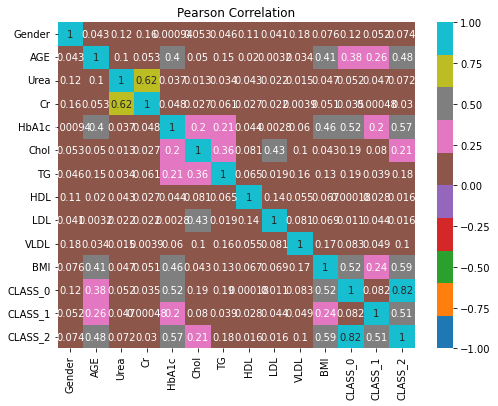

HDL        0.000184
LDL        0.010858
Cr         0.035244
Urea       0.052351
CLASS_1    0.081807
VLDL       0.083117
Gender     0.120338
TG         0.185089
Chol       0.188953
AGE        0.379792
BMI        0.516275
HbA1c      0.522585
CLASS_2    0.816825
CLASS_0    1.000000
Name: CLASS_0, dtype: float64
Cr         0.000477
HDL        0.028001
TG         0.039025
LDL        0.043848
Urea       0.046913
VLDL       0.049219
Gender     0.052028
Chol       0.080384
CLASS_0    0.081807
HbA1c      0.200683
BMI        0.241542
AGE        0.258576
CLASS_2    0.508129
CLASS_1    1.000000
Name: CLASS_1, dtype: float64
LDL        0.015997
HDL        0.016367
Cr         0.030181
Urea       0.072395
Gender     0.073878
VLDL       0.100317
TG         0.182539
Chol       0.209817
AGE        0.477878
CLASS_1    0.508129
HbA1c      0.567766
BMI        0.585964
CLASS_0    0.816825
CLASS_2    1.000000
Name: CLASS_2, dtype: float64


In [26]:
corr = df.corr(method='pearson').abs()

corr.describe()
corr.head()

fig = plt.figure(figsize=(8,6))
sns.heatmap(corr, annot=True, cmap='tab10', vmin=-1, vmax=+1)
plt.title('Pearson Correlation')
plt.show()

print (df.corr()['CLASS_0'].abs().sort_values())
print (df.corr()['CLASS_1'].abs().sort_values())
print (df.corr()['CLASS_2'].abs().sort_values())

### 6.2 Univariate Selection using SelectKBest

In [27]:
X = df.iloc[:,0:20]  #independent columns
y = df.iloc[:,-1]    #target column

#apply SelectKBest class to extract top 10 best features
bestfeatures = SelectKBest(score_func=chi2, k=10)
fit = bestfeatures.fit(X,y)
dfscores = pd.DataFrame(fit.scores_)
dfcolumns = pd.DataFrame(X.columns)

#concat two dataframes for better visualization
featureScores = pd.concat([dfcolumns,dfscores],axis=1)
featureScores.columns = ['Specs','Score']  #naming the dataframe columns
print(featureScores.nlargest(13,'Score'))  #print 10 best features

      Specs       Score
11  CLASS_0  487.058824
1       AGE  273.280702
10      BMI  240.069022
4     HbA1c  216.346463
12  CLASS_1  202.941176
13  CLASS_2  136.000000
9      VLDL   57.900939
3        Cr   38.617000
6        TG   24.316273
5      Chol   13.092608
2      Urea    7.900296
0    Gender    2.527052
8       LDL    0.104614


### 6.3 Feature Importance

[0.00105327 0.03476617 0.00097454 0.00083089 0.03253989 0.00412683
 0.00342291 0.00082639 0.0016456  0.00092621 0.04484297 0.29892559
 0.1056135  0.46950523]


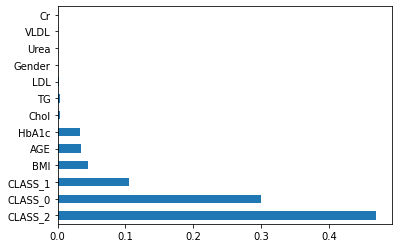

In [28]:
X = df.iloc[:,0:20]  #independent columns
y = df.iloc[:,-1]    #target column i.e price range

model = ExtraTreesClassifier()
model.fit(X,y)
print(model.feature_importances_) #use inbuilt class feature_importances of tree based classifiers

#plot graph of feature importances for better visualization
feat_importances = pd.Series(model.feature_importances_, index=X.columns)
feat_importances.nlargest(13).plot(kind='barh')
plt.show()

### 6.4 Correlation Matrix with Heatmap

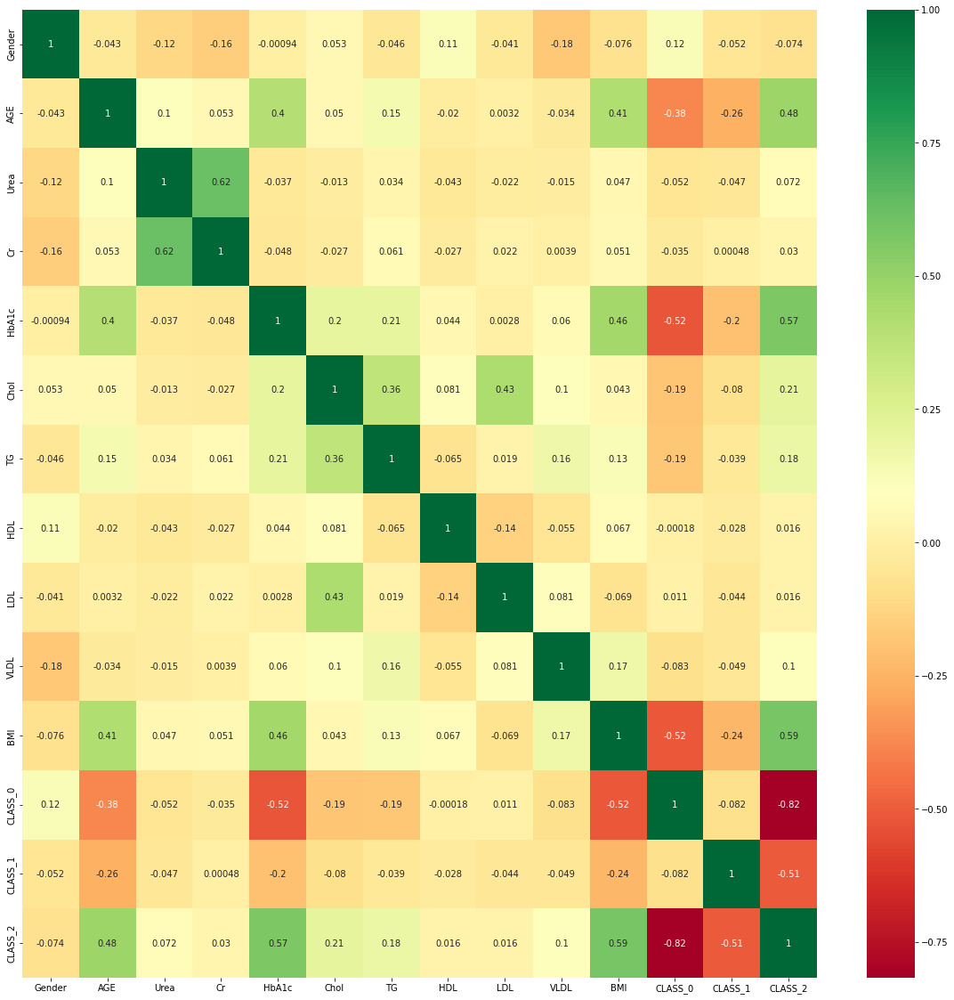

In [29]:
X = df.iloc[:,0:20]  #independent columns
y = df.iloc[:,-1]    #target column

#get correlations of each features in dataset
corrmat = df.corr()
top_corr_features = corrmat.index
plt.figure(figsize=(20,20))

#plot heat map
g=sns.heatmap(df[top_corr_features].corr(),annot=True,cmap="RdYlGn")

# 7. Applying Different Models On Train & Test Data #only suggestion feel free to try out other models :)

### 7.1) Model 1 - GBM (Gradient Boosting)

a) Define model parameters to be tuned
b) Using GridSearch Cross Validation to find out the best parameters using L2 penalty
c) Displaying the best parameters
d) Refitting the model with best parameters
e) Displaying model prediction and classification report
f) Saving the variables used in the model
g) Saving the best model
h) Model Evaluation
i) Making predictions for test data
j) Evaluating prediction accuracy for test data¶



In [30]:
import  lightgbm as lgb
from sklearn.model_selection import train_test_split
from sklearn import metrics

/home/emcy/.local/lib/python3.10/site-packages/lightgbm/sklearn.py:736: UserWarning: 'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose' argument is deprecated and will be removed in a future release of LightGBM. "
/home/emcy/.local/lib/python3.10/site-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_confusion_matrix is deprecated; Function `plot_confusion_matrix` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: ConfusionMatrixDisplay.from_predictions or ConfusionMatrixDisplay.from_estimator.
  warnings.warn(msg, category=FutureWarning)


[30]	training's multi_logloss: 0.072109	valid_0's multi_logloss: 0.225409
[60]	training's multi_logloss: 0.0196772	valid_0's multi_logloss: 0.225203
[90]	training's multi_logloss: 0.00591342	valid_0's multi_logloss: 0.240197
Training accuracy 1.000000
Testing accuracy 0.928889
              precision    recall  f1-score   support

           0       0.87      0.81      0.84        91
           1       0.47      0.29      0.35        49
           2       0.95      0.98      0.97       760

    accuracy                           0.93       900
   macro avg       0.76      0.69      0.72       900
weighted avg       0.92      0.93      0.92       900



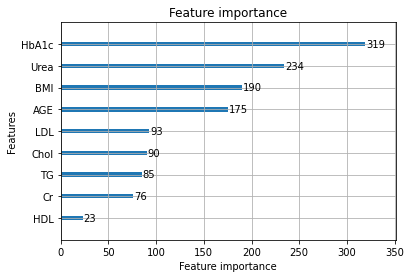

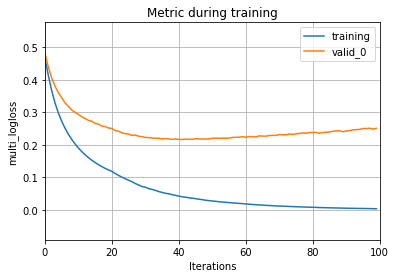

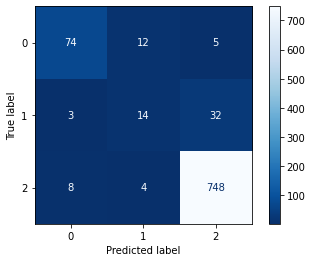

In [31]:
diabetes_gbm = data_new
diabetes_gbm.shape

# define input and output features to train model
x = diabetes_gbm.drop(['CLASS','Gender','VLDL'],axis=1)
y = diabetes_gbm.CLASS

# train and test splitting
x_train,x_test,y_train,y_test = train_test_split(x,y,test_size=0.90,random_state=42)
model = lgb.LGBMClassifier(learning_rate=0.08,max_depth=-3,random_state=42)
model.fit(x_train,y_train,eval_set=[(x_test,y_test),(x_train,y_train)],
          verbose=30,eval_metric='logloss')
print("Training accuracy {:4f}".format(model.score(x_train,y_train)))
print("Testing accuracy {:4f}".format(model.score(x_test,y_test)))

lgb.plot_importance(model)
lgb.plot_metric(model)
metrics.plot_confusion_matrix(model,x_test,y_test,cmap='Blues_r')
print(metrics.classification_report(y_test,model.predict(x_test)))

In [32]:
# other way of doing GBM
import sklearn
import pandas as pd
import numpy as np 

from sklearn.metrics import classification_report
from sklearn.model_selection import KFold
from sklearn.ensemble import GradientBoostingClassifier

#new version of the dataset. 
diabetes_sklearn = data_new
diabetes_sklearn.head()

x,y = diabetes_sklearn.drop('CLASS',axis=1),diabetes_sklearn.CLASS

kf = KFold(n_splits=5,random_state=42,shuffle=True)

for train_index,val_index in kf.split(x):
    x_train,x_val = x.iloc[train_index],x.iloc[val_index]
    y_train,y_val = y.iloc[train_index],y.iloc[val_index]
    
gradient_booster = GradientBoostingClassifier(learning_rate=0.1)
gradient_booster.get_params()

gradient_booster.fit(x_train,y_train)
print(classification_report(y_val,gradient_booster.predict(x_val)))

              precision    recall  f1-score   support

           0       0.92      0.96      0.94        25
           1       1.00      1.00      1.00         7
           2       0.99      0.99      0.99       168

    accuracy                           0.98       200
   macro avg       0.97      0.98      0.98       200
weighted avg       0.99      0.98      0.99       200



### 7.2) Model 2 - Logistic Regression

a) Applying logistic regression
b) Displaying model prediction and classification report
c) Saving the variables used in the model¶
d) Saving the best model
e) Model Evaluation
f) Making predictions for test data
g) Evaluating prediction accuracy for test data



### 7.3) Model 3 - Random Forest Classifier

a) Define model parameters to be tuned
b) Using GridSearch Cross Validation to find out the best parameters using L2 penalty
c) Displaying the best parameters
d) Refitting the model with the best parameters
e) Displaying model prediction and classification report
f) Saving the variables used in the model
g) Saving the best model
h) Model Evaluation
i) Making predictions for test data
j) Evaluating prediction accuracy for test data



# 8. Displaying Best Model